# Imports

In [6]:
# Modules and libraries 
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [7]:
# Tables 
df_patient = pd.read_csv('data/patient_group.csv')
df_chart = pd.read_csv('data/chartevents_new.csv')
df_lab = pd.read_csv('data/labevents_pre_extub.csv')

FileNotFoundError: [Errno 2] File data/patient_group.csv does not exist: 'data/patient_group.csv'

# Patient Data 

In [8]:
df_patient.head()

NameError: name 'df_patient' is not defined

In [9]:
df_patient.shape

NameError: name 'df_patient' is not defined

In [ ]:
df_patient.info()

In [6]:
df_patient.icustay_id.nunique()

5897

5897 unique ICU stays. 

# Chartevent Data 

In [7]:
df_chart.head()

,hadm_id,icustay_id,itemid,charttime,value,valuenum,valueuom,item,storetime,cgid,warning,error,resultstatus,stopped
0,100016.0,217590.0,220045.0,2188-05-28 08:00:00,91,91.0,bpm,hr,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
1,100016.0,217590.0,220181.0,2188-05-28 08:00:00,88,88.0,mmHg,blood_pr,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
2,100016.0,217590.0,220210.0,2188-05-28 08:00:00,18,18.0,insp/min,resp_rat,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
3,100016.0,217590.0,220339.0,2188-05-28 08:00:00,5,5.0,cmH2O,PEEP,2188-05-28 07:36:00,20803.0,0.0,0.0,NaN,NaN
4,100016.0,217590.0,220546.0,2188-05-28 05:16:00,10.7,10.7,K/uL,leuko,2188-05-28 06:05:00,20889.0,0.0,0.0,NaN,NaN


In [8]:
df_chart.icustay_id.nunique()

5952

# Laboratory Data 

In [9]:
df_lab.head()

,hadm_id,icustay_id,itemid,value,ts,item
0,100016,217590.0,50802,2,2188-05-24 17:24:00,base_excess
1,100016,217590.0,50820,7.43,2188-05-24 17:24:00,pH
2,100016,217590.0,50821,86,2188-05-24 17:24:00,Pa02
3,100016,217590.0,50912,1.1,2188-05-28 04:16:00,creatinin
4,100016,217590.0,51221,31.1,2188-05-28 04:16:00,hct


In [10]:
df_lab.shape

(35188, 6)

In [11]:
df_lab.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35188 entries, 0 to 35187
Data columns (total 6 columns):
hadm_id       35188 non-null int64
icustay_id    35188 non-null float64
itemid        35188 non-null int64
value         35188 non-null object
ts            35188 non-null object
item          35188 non-null object
dtypes: float64(1), int64(2), object(3)
memory usage: 1.6+ MB


##### Investigate one ICT stay

In [12]:
df_lab[df_lab.icustay_id==200006]

,hadm_id,icustay_id,itemid,value,ts,item
31277,189514,200006.0,50912,0.8,2159-09-04 02:17:00,creatinin
31278,189514,200006.0,51221,24.8,2159-09-04 05:21:00,hct
31279,189514,200006.0,51222,8.7,2159-09-04 05:21:00,hb


##### Differences between the tables

The patient table has less (#5848) unique ICU stay ID's than the laboratory table (#5937). 
Thus, the laboratory data contains information, that has already been dropped in the patient dataframe. Since the patient dataframe is the main frame we will merge that laboratory data on, the remaining ICU stay ID's will not be converted during the merge. 

# Merge patient & laboratory data

##### Pivoting laboratory data 

In [5]:
pivot_table = df_lab.pivot_table(index='icustay_id',
                                     columns='item', 
                                     values='value',
                                     aggfunc=lambda x: ' '.join(x))

NameError: name 'df_lab' is not defined

In [15]:
pivot_table.shape

(5937, 6)

In [4]:
pivot_table.head(3)

NameError: name 'pivot_table' is not defined

In [17]:
df_patient_lab = df_patient.merge(right=pivot_table, how= 'inner' , on='icustay_id')

In [18]:
df_patient_lab.head(3)

,label,hadm_id,icustay_id,SUBJECT_ID,gender,admittime,dob,sub_age,last_icd9_code,numb_diagn,last_careunit,los,tracheo,Pa02,base_excess,creatinin,hb,hct,pH
0,1,100016,217590,68591,M,2188-05-24 15:06:00,2132-11-19 00:00:00,56.0,V441,11,MICU,6.1731,1,86,2,1.1,10.3,31.1,7.43
1,1,100017,258320,16229,M,2103-03-11 01:54:00,2075-11-10 00:00:00,28.0,3017,8,MICU,0.6924,0,171,4,0.8,14.3,41.4,7.52
2,1,100035,245719,48539,M,2115-02-22 07:51:00,2078-08-09 00:00:00,37.0,4280,26,MICU,10.5061,0,39,10,1.1,14.0,40.5,7.41
3,1,100063,241782,69282,M,2181-04-20 14:00:00,2135-04-05 00:00:00,46.0,311,11,MICU,1.6501,0,365,2,1.0,14.0,42.0,7.39
4,1,100087,294404,42255,M,2126-11-01 18:47:00,2069-11-06 00:00:00,57.0,4280,18,CCU,3.7287,0,143,5,0.7,15.2,44.8,7.47


In [19]:
df_patient_lab.shape

(5884, 19)

In [20]:
df_patient_lab.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5884 entries, 0 to 5883
Data columns (total 19 columns):
label             5884 non-null int64
hadm_id           5884 non-null int64
icustay_id        5884 non-null int64
SUBJECT_ID        5884 non-null int64
gender            5884 non-null object
admittime         5884 non-null object
dob               5884 non-null object
sub_age           5884 non-null float64
last_icd9_code    5884 non-null object
numb_diagn        5884 non-null int64
last_careunit     5884 non-null object
los               5884 non-null float64
tracheo           5884 non-null int64
Pa02              5749 non-null object
base_excess       5749 non-null object
creatinin         5879 non-null object
hb                5873 non-null object
hct               5875 non-null object
pH                5760 non-null object
dtypes: float64(2), int64(6), object(11)
memory usage: 919.4+ KB


In [21]:
df_patient_lab.icustay_id.nunique()

5884

##### Did we loose information during the merge process? 

In [22]:
#Subtracting the original laboratory data from the original patient data
set1= set(df_patient.icustay_id.unique())
set2= set(df_lab.icustay_id.unique())
x = set2 - set1

In [23]:
len(x)

53

The laboratory dataframe contains 53 unique ICU stay ID's that are not in the patient table. 

In [24]:
#Subtracting the merged patient&lav dataframe from the original patient dataframe
set3= set(df_patient.icustay_id.unique())
set4= set(df_patient_lab.icustay_id.unique())
y = set3 - set4

In [25]:
len(y)

13

The patient dataframe contains 13 unique ICU stay ID's that are not in the merged patient&lab dataframe. 

In [26]:
# ICU stay ID's of the 13 lost ICU stays during the merge process
y

{207592,
 217184,
 220248,
 229783,
 241652,
 242037,
 247383,
 249265,
 253733,
 267422,
 281726,
 283586,
 287137}

# Merge Chartevents with Patient&Lab 

In [27]:
df_chart.head(3)

,hadm_id,icustay_id,itemid,charttime,value,valuenum,valueuom,item,storetime,cgid,warning,error,resultstatus,stopped
0,100016.0,217590.0,220045.0,2188-05-28 08:00:00,91,91.0,bpm,hr,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
1,100016.0,217590.0,220181.0,2188-05-28 08:00:00,88,88.0,mmHg,blood_pr,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
2,100016.0,217590.0,220210.0,2188-05-28 08:00:00,18,18.0,insp/min,resp_rat,2188-05-28 08:02:00,15623.0,0.0,0.0,NaN,NaN
3,100016.0,217590.0,220339.0,2188-05-28 08:00:00,5,5.0,cmH2O,PEEP,2188-05-28 07:36:00,20803.0,0.0,0.0,NaN,NaN
4,100016.0,217590.0,220546.0,2188-05-28 05:16:00,10.7,10.7,K/uL,leuko,2188-05-28 06:05:00,20889.0,0.0,0.0,NaN,NaN


In [28]:
df_chart.columns

Index(['hadm_id', 'icustay_id', 'itemid', 'charttime', 'value', 'valuenum',
       'valueuom', 'item', 'storetime', 'cgid', 'warning', 'error',
       'resultstatus', 'stopped'],
      dtype='object')

##### Pivoting of chartevents dataframe 

In [29]:
# df_chart pivotieren
pivot_table_chart = df_chart.pivot_table(index='icustay_id',
                                     columns='item', 
                                     values='value',
                                     aggfunc=lambda x: ' '.join(str(v) for v in x))

In [30]:
pivot_table_chart.head(3)

item,FiO2,PEEP,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol
icustay_id,,,,,,,,,,,,
200006.0,0.4000000059604645,5.0,99.0,70.0,NaN,71.0,NaN,4.2,7.0,16.0,36.5,395.0
200059.0,0.4000000059604645,5.0,99.0,103.0,3.5999999046325684,98.0,1.5,16.1,7.0,25.0,36.83330154418945,326.0
200063.0,50,5,97,82,23.3,103,1.1,7.3,12,19,NaN,959
200065.0,.40000000596046448,5,96,107.66699981689453,NaN,101,3.6,30.2,8,35,36.555599212646484,398
200077.0,.5,5,98,65.666702270507812,NaN,91,2,10.1,11.699999809265137,29,35.611099243164062,600


In [31]:
df_patient_lab_chart = df_patient_lab.merge(right=pivot_table_chart, how= 'inner' , on='icustay_id')

In [32]:
df_patient_lab_chart.head(3)

,label,hadm_id,icustay_id,SUBJECT_ID,gender,admittime,dob,sub_age,last_icd9_code,numb_diagn,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol
0,1,100016,217590,68591,M,2188-05-24 15:06:00,2132-11-19 00:00:00,56.0,V441,11,...,100,88,6.2,91,NaN,10.7,6,18,NaN,653
1,1,100017,258320,16229,M,2103-03-11 01:54:00,2075-11-10 00:00:00,28.0,3017,8,...,100,91.333297729492188,NaN,67,1.1,9.3,6.4000000953674316,20,37.833301544189453,430
2,1,100035,245719,48539,M,2115-02-22 07:51:00,2078-08-09 00:00:00,37.0,4280,26,...,95,138,6.5,81,1,17.2,6,16,37.9,151
3,1,100063,241782,69282,M,2181-04-20 14:00:00,2135-04-05 00:00:00,46.0,311,11,...,100,85,7.6,76,NaN,8.4,1,18,NaN,441
4,1,100087,294404,42255,M,2126-11-01 18:47:00,2069-11-06 00:00:00,57.0,4280,18,...,97,105,10.8,94,1.3,8.5,7,17,NaN,481


In [33]:
df_patient_lab_chart.columns

Index(['label', 'hadm_id', 'icustay_id', 'SUBJECT_ID', 'gender', 'admittime',
       'dob', 'sub_age', 'last_icd9_code', 'numb_diagn', 'last_careunit',
       'los', 'tracheo', 'Pa02', 'base_excess', 'creatinin', 'hb', 'hct', 'pH',
       'FiO2', 'PEEP', 'SaO2', 'blood_pr', 'breath_min_vol', 'hr',
       'lactic_acid', 'leuko', 'mean_insp_pressure', 'resp_rat', 'temp',
       'tidal_vol'],
      dtype='object')

In [34]:
df_patient_lab_chart.shape

(5884, 31)

In [35]:
df_patient_lab_chart.icustay_id.nunique()

5884

##### Delete irrelevant columns for further analysis

In [36]:
df_patient_lab_chart.columns

Index(['label', 'hadm_id', 'icustay_id', 'SUBJECT_ID', 'gender', 'admittime',
       'dob', 'sub_age', 'last_icd9_code', 'numb_diagn', 'last_careunit',
       'los', 'tracheo', 'Pa02', 'base_excess', 'creatinin', 'hb', 'hct', 'pH',
       'FiO2', 'PEEP', 'SaO2', 'blood_pr', 'breath_min_vol', 'hr',
       'lactic_acid', 'leuko', 'mean_insp_pressure', 'resp_rat', 'temp',
       'tidal_vol'],
      dtype='object')

In [37]:
# Columns to drop
to_drop = ['admittime', 'dob', 'last_icd9_code']
df_patient_lab_chart.drop(columns= to_drop, inplace=True)

In [38]:
df_patient_lab_chart.head(3)

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol
0,1,100016,217590,68591,M,56.0,11,MICU,6.1731,1,...,100,88,6.2,91,NaN,10.7,6,18,NaN,653
1,1,100017,258320,16229,M,28.0,8,MICU,0.6924,0,...,100,91.333297729492188,NaN,67,1.1,9.3,6.4000000953674316,20,37.833301544189453,430
2,1,100035,245719,48539,M,37.0,26,MICU,10.5061,0,...,95,138,6.5,81,1,17.2,6,16,37.9,151
3,1,100063,241782,69282,M,46.0,11,MICU,1.6501,0,...,100,85,7.6,76,NaN,8.4,1,18,NaN,441
4,1,100087,294404,42255,M,57.0,18,CCU,3.7287,0,...,97,105,10.8,94,1.3,8.5,7,17,NaN,481


In [39]:
df_patient_lab_chart.shape

(5884, 28)

In [40]:
df_patient_lab_chart.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5884 entries, 0 to 5883
Data columns (total 28 columns):
label                 5884 non-null int64
hadm_id               5884 non-null int64
icustay_id            5884 non-null int64
SUBJECT_ID            5884 non-null int64
gender                5884 non-null object
sub_age               5884 non-null float64
numb_diagn            5884 non-null int64
last_careunit         5884 non-null object
los                   5884 non-null float64
tracheo               5884 non-null int64
Pa02                  5749 non-null object
base_excess           5749 non-null object
creatinin             5879 non-null object
hb                    5873 non-null object
hct                   5875 non-null object
pH                    5760 non-null object
FiO2                  5855 non-null object
PEEP                  5850 non-null object
SaO2                  5883 non-null object
blood_pr              5884 non-null object
breath_min_vol        2895 non-null o

##### Save current dataframe for data cleaning

In [41]:
df_raw = df_patient_lab_chart

In [42]:
df_raw.to_csv('./data/mimic_dataset.csv', index = False)

# Data Cleaning

##### Load dataframe 

In [43]:
df_raw = pd.read_csv('./data/mimic_dataset.csv')

## Investigate label 

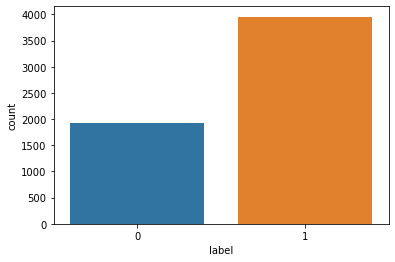

In [44]:
sns.countplot(df_raw.label);

1 = Succeeded extubation 
 
2 = Failed extubation 

## Function for Cleaning

In [45]:
def cleaning(x, check_num=False):
    """Checking a dataframe column:
    - unique values
    - numbers as strings
    - Missing values"""

    print(f'Amount of unique values: {x.nunique()}')
    if x.nunique() < 20:
        print(f'Unique Values: {x.unique()}')
        print(f'Value counts: {x.value_counts()}\n')
    else:
        print('More than 20 unique values. No printing of details.\n')
    
    if check_num==True and x.dtype=='object':
        errors = []
        for i in x.index:
            try:
                float(x.loc[i])
            except:
                errors.append([i, x.loc[i]])
        if len(errors) > 0:
            print("""Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.""")
            print(errors, '\n')
    
    print(f'Missing in {x.name}: {round(x.isnull().sum()/len(x)*100,2)}%')
    print(f'Null-Values: {x.isnull().sum()}\n')

def replacement(x, nan_repl):
    """Getting a column from a dataframe with numbers as string. Replace strings with NaN
    and replace the NaN-values with median or mean (nan_repl)"""
    x = pd.to_numeric(x, errors='coerce')
    
    if nan_repl=='median':
        x.fillna(x.median(), inplace=True)
    if nan_repl=='mean':
        x.fillna(x.mean(), inplace=True)
        
    cleaning(x, True)
    return x

In [46]:
df_raw.head(3)

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol
0,1,100016,217590,68591,M,56.0,11,MICU,6.1731,1,...,100,88.000000,6.2,91.0,NaN,10.7,6.0,18.0,NaN,653.0
1,1,100017,258320,16229,M,28.0,8,MICU,0.6924,0,...,100,91.333298,NaN,67.0,1.1,9.3,6.4,20.0,37.833302,430.0
2,1,100035,245719,48539,M,37.0,26,MICU,10.5061,0,...,95,138.000000,6.5,81.0,1,17.2,6.0,16.0,37.900000,151.0
3,1,100063,241782,69282,M,46.0,11,MICU,1.6501,0,...,100,85.000000,7.6,76.0,NaN,8.4,1.0,18.0,NaN,441.0
4,1,100087,294404,42255,M,57.0,18,CCU,3.7287,0,...,97,105.000000,10.8,94.0,1.3,8.5,7.0,17.0,NaN,481.0


In [47]:
df_raw.shape

(5884, 28)

In [49]:
df_raw.iloc[:,0:10].head(3)

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo
0,1,100016,217590,68591,M,56.0,11,MICU,6.1731,1
1,1,100017,258320,16229,M,28.0,8,MICU,0.6924,0
2,1,100035,245719,48539,M,37.0,26,MICU,10.5061,0
3,1,100063,241782,69282,M,46.0,11,MICU,1.6501,0
4,1,100087,294404,42255,M,57.0,18,CCU,3.7287,0


##### Overall Missing Values 

In [50]:
df_raw.isnull().sum()

label                    0
hadm_id                  0
icustay_id               0
SUBJECT_ID               0
gender                   0
sub_age                  0
numb_diagn               0
last_careunit            0
los                      0
tracheo                  0
Pa02                   135
base_excess            135
creatinin                5
hb                      11
hct                      9
pH                     124
FiO2                    51
PEEP                    78
SaO2                    17
blood_pr                15
breath_min_vol        3038
hr                       8
lactic_acid           1280
leuko                  301
mean_insp_pressure     154
resp_rat                12
temp                  2506
tidal_vol               74
dtype: int64

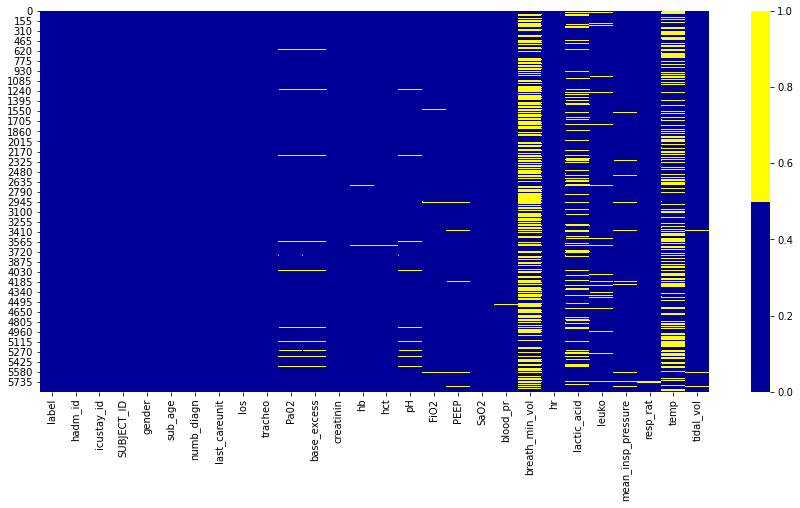

In [52]:
plt.figure(figsize=(15,7))
cols = df_raw.columns # first 30 columns
colours = ['#000099', '#ffff00'] # specify the colours - yellow is missing. blue is not missing.
sns.heatmap(df_raw[cols].isnull(), cmap=sns.color_palette(colours));

## Gender

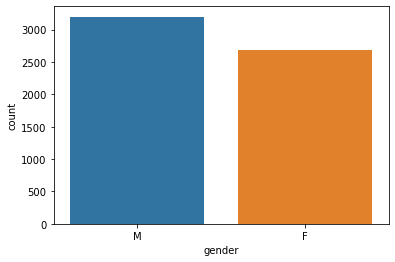

In [53]:
sns.countplot(df_raw.gender);

In [54]:
df_gender = df_raw.icustay_id.groupby(df_raw.gender).count()
df_gender['perc'] = df_gender / df_gender.sum()
df_gender

gender
F                                                    2685
M                                                    3199
perc    gender
F    0.456322
M    0.543678
Name: icust...
Name: icustay_id, dtype: object

There are 514 more male than female patients in the dataset. 

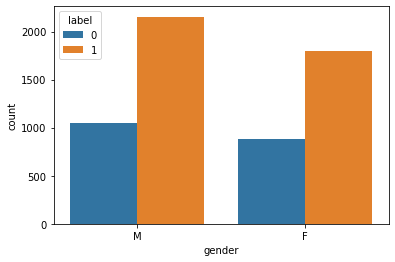

In [55]:
sns.countplot(df_raw.gender, hue=df_raw.label);

Gender is equally distributed between the label. Since there are no missing values, there is no need for further data cleaning.

## Age

In [56]:
cleaning(df_raw.sub_age, True)

Amount of unique values: 74
More than 20 unique values. No printing of details.

Missing in sub_age: 0.0%
Null-Values: 0



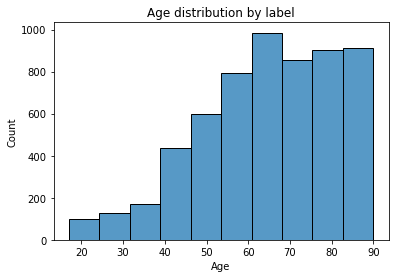

In [57]:
sns.histplot(df_raw.sub_age, bins=10)
plt.title('Age distribution by label')
plt.xlabel('Age');

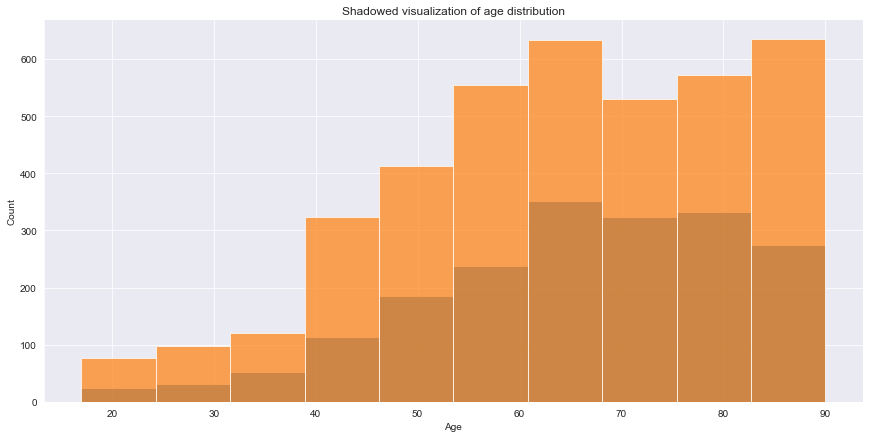

In [58]:
#sns.color_palette("vlag", as_cmap=True)
sns.set_style('darkgrid')
g = sns.FacetGrid(df_raw,hue="label",height=6,aspect=2)
g = g.map(plt.hist,'sub_age',bins=10,alpha=0.7)
plt.title('Shadowed visualization of age distribution')
plt.xlabel('Age')
plt.ylabel('Count');

This plot shows two histograms layered on top of each other. As there are more succeeded extubations, the bars of the histogram reach higher.

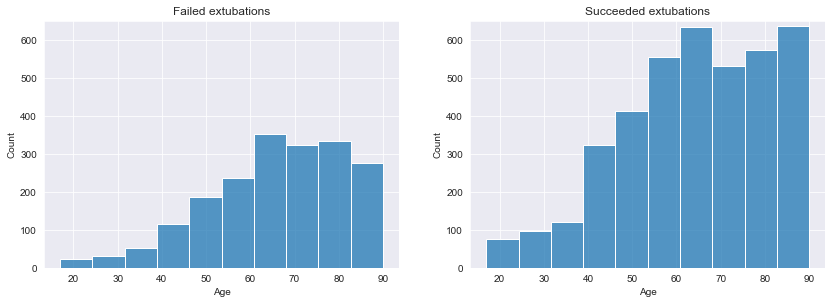

In [59]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].sub_age, bins=10)
ax1.set_ylim(0,650)
plt.xlabel('Age')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].sub_age, bins=10)
ax2.set_ylim(0,650)
plt.xlabel('Age')
plt.title('Succeeded extubations');

This visualizations allows a glance at the age distribution of the the two label groups (failed and succeeded extubations) in seperate plots. 

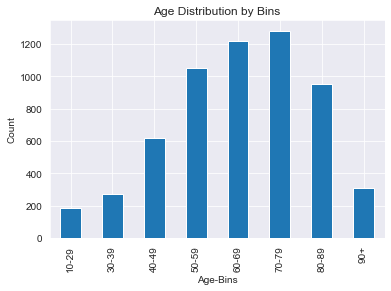

In [60]:
# Create bins to have another view at the age distribution

x_names = ['10-29','30-39','40-49','50-59','60-69','70-79','80-89','90+']
bins = [10, 30, 40, 50, 60, 70, 80, 90, 100]
cat = pd.cut(df_raw.sub_age, bins, right=False, labels=x_names)

df1 = df_raw.groupby(pd.cut(df_raw['sub_age'], 
                            bins=bins, right=False,labels=x_names)).sub_age.count()
df1.plot(kind='bar')
plt.title('Age Distribution by Bins')
plt.ylabel('Count')
plt.xlabel('Age-Bins');

Age is normally distributed across the dataset. 

In [61]:
# Seperate bins by label 
df_f = df_raw[df_raw.label == 0].groupby(pd.cut(df_raw[df_raw.label == 0]['sub_age'], bins=bins, right=False,labels=x_names)).sub_age.count()
df_s = df_raw[df_raw.label == 1].groupby(pd.cut(df_raw[df_raw.label == 1]['sub_age'], bins=bins, right=False,labels=x_names)).sub_age.count()
print(df_f)
print(df_s)


sub_age
10-29     46
30-39     74
40-49    166
50-59    327
60-69    430
70-79    480
80-89    317
90+       88
Name: sub_age, dtype: int64
sub_age
10-29    137
30-39    195
40-49    451
50-59    723
60-69    788
70-79    801
80-89    638
90+      223
Name: sub_age, dtype: int64


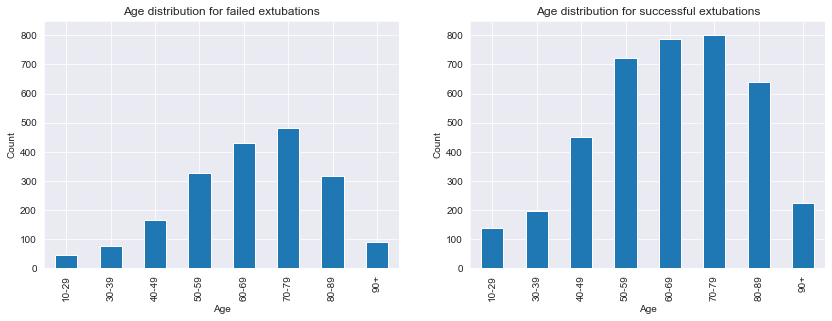

In [62]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = df_f.plot(kind='bar')
ax1.set_ylim(0,850)
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Age distribution for failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = df_s.plot(kind='bar')
ax2.set_ylim(0,850)
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Age distribution for successful extubations');

No obvious differences of the age distribution between failed and succesful extubations in this dataset. 

# Number of Diagnosis 

In [63]:
f'Maximum number of diagnosis per patient: {(df_raw.numb_diagn.max())}'

'Maximum number of diagnosis per patient: 39'

In [64]:
f'Minimum number of diagnosis per patient: {(df_raw.numb_diagn.min())}'

'Minimum number of diagnosis per patient: 2'

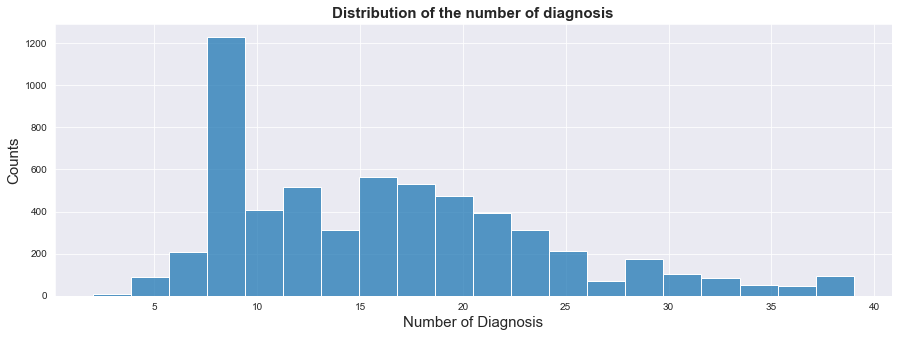

In [65]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.numb_diagn, bins=20)
ax.set_title("Distribution of the number of diagnosis", fontsize=15, fontweight="bold")
ax.set_ylabel('Counts', fontsize=15)
ax.set_xlabel('Number of Diagnosis', fontsize=15);

It appears that a certain number of diagnosis is very common. Let's have a look what number of diagnosis it is. 

In [66]:
df_raw.numb_diagn.value_counts()[:5].sort_values(ascending=False)

9     1039
14     311
16     285
15     281
17     273
Name: numb_diagn, dtype: int64

In [67]:
df_raw.numb_diagn.value_counts().max()

1039

In [68]:
f'{round(df_raw.numb_diagn.value_counts().max()/len(df_raw)*100,2)}% of the patients have 9 diagnosis.'

'17.66% of the patients have 9 diagnosis.'

An 1038 patients in this dataset have 9 diagnosis. That makes 17% of the entire patients in the dataset. 

# Last Careunit 
 
The last careunit contains the last ICU type in which the patient was cared for.
* MICU: Medical Intensive Care Unit
* CCU: Coronary Care Unit
* SICU: Surgical Intensive Care Unit
* TSICU: Trauma Surgical Intensive Care Unit
* CSRU: Stroke Receiving Unit 

In [69]:
cleaning(df_raw.last_careunit)

Amount of unique values: 5
Unique Values: ['MICU' 'CCU' 'SICU' 'TSICU' 'CSRU']
Value counts: MICU     3659
SICU      857
CCU       625
TSICU     439
CSRU      304
Name: last_careunit, dtype: int64

Missing in last_careunit: 0.0%
Null-Values: 0



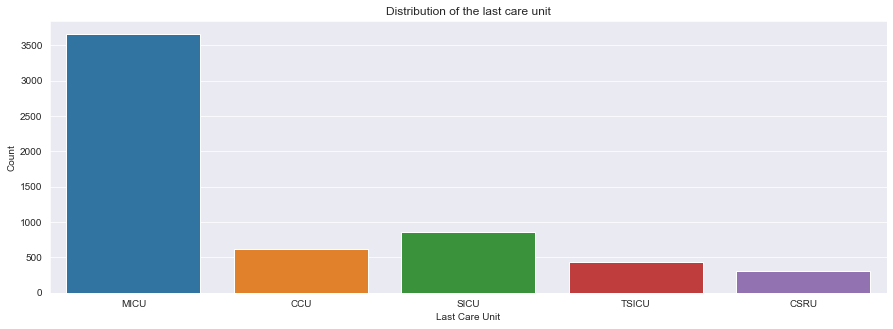

In [70]:
plt.figure(figsize=(15,5))
sns.countplot(df_raw.last_careunit)
plt.xlabel('Last Care Unit')
plt.ylabel('Count')
plt.title('Distribution of the last care unit');

In [71]:
print(f'{round(df_raw.last_careunit.value_counts().max()/len(df_raw)*100,2)}% of the patients were last treated in the Medical Intensive Care Unit.')

62.19% of the patients were last treated in the Medical Intensive Care Unit.


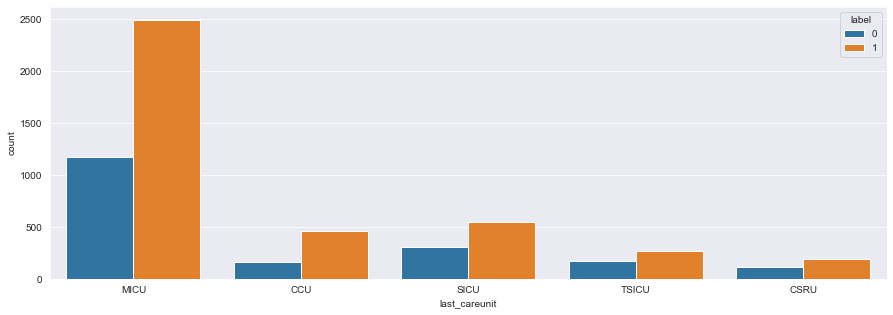

In [72]:
plt.figure(figsize=(15,5))
plt.legend(['Failed', 'Success'])
sns.countplot(df_raw.last_careunit, hue=df_raw.label);


Each ICU unit contains succeeded and failed extubations. In line with the overall distribution of succeeded and failed extubations, there are more succeeded extubations than failed extubations in each unit. 

# Length of stay

In [73]:
cleaning(df_raw.los, True)

Amount of unique values: 5784
More than 20 unique values. No printing of details.

Missing in los: 0.0%
Null-Values: 0



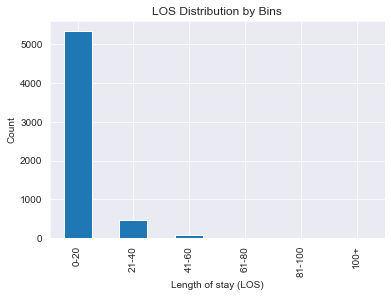

In [74]:
# Create bins to have another view at the length of stay

x_names = ['0-20','21-40','41-60','61-80','81-100','100+']
bins = [0, 21, 41, 61, 81, 101, 120]
cat = pd.cut(df_raw.los, bins, right=False, labels=x_names)

df1 = df_raw.groupby(pd.cut(df_raw['los'], 
                            bins=bins, right=False,labels=x_names)).los.count()
df1.plot(kind='bar')
plt.title('LOS Distribution by Bins')
plt.ylabel('Count')
plt.xlabel('Length of stay (LOS)');

In [75]:
df1

los
0-20      5327
21-40      473
41-60       76
61-80        6
81-100       1
100+         1
Name: los, dtype: int64

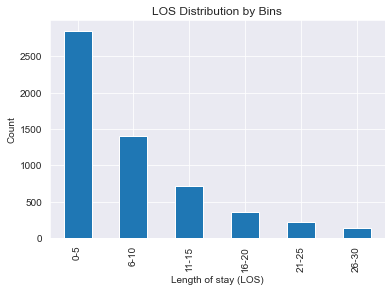

In [76]:
# Create bins to have another view at the length of stay less than 30 days LOS

x_names = ['0-5','6-10','11-15','16-20','21-25','26-30']
bins = [0, 6, 11, 16, 21, 26, 31]
cat = pd.cut(df_raw.los, bins, right=False, labels=x_names)

df1 = df_raw.groupby(pd.cut(df_raw['los'], 
                            bins=bins, right=False,labels=x_names)).los.count()
df1.plot(kind='bar')
plt.title('LOS Distribution by Bins')
plt.ylabel('Count')
plt.xlabel('Length of stay (LOS)');

# Tracheostomy

Tracheotomy is a surgical procedure which consists of making an incision (cut) on the anterior aspect (front) of the neck and opening a direct airway through an incision in the trachea (windpipe). The resulting stoma (hole) can serve independently as an airway or as a site for a tracheal tube or tracheostomy tube to be inserted; this tube allows a person to breathe without the use of the nose or mouth. [Source](https://en.wikipedia.org/wiki/Tracheotomy)

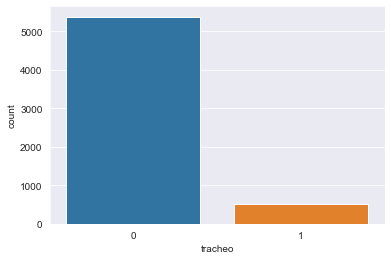

In [77]:
sns.countplot(df_raw.tracheo);

Majority of the patients have not undergone a tracheostomy. 

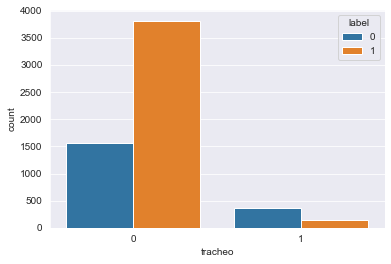

In [78]:
sns.countplot(df_raw.tracheo, hue=df_raw.label);

Dividing the tracheostomy occuranced by label, it is interesting to observe that the ratio of tracheostomy occurance differs between succeweded and failed extubations. Looking at the patients that have had a tracheostomy, majority of the extubations failed, whereas of patients without a tracheostomy occurane, majority of the extubations succeeded. 

# PaO<sub>2</sub>: Partial Pressure of Oxygen

In [79]:
cleaning(df_raw.Pa02, True)

Amount of unique values: 374
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[1774, 'DISREGARD PREVIOUS RESULT OF 156'], [2267, 'DISREGARD RESULTS']] 

Missing in Pa02: 2.29%
Null-Values: 135



##### Replacement of null values with the median

In [80]:
df_raw.Pa02 = replacement(df_raw.Pa02, 'median')

Amount of unique values: 372
More than 20 unique values. No printing of details.

Missing in Pa02: 0.0%
Null-Values: 0



In [81]:
df_raw.Pa02.describe()

count    5884.000000
mean      120.570870
std        63.739632
min        16.000000
25%        84.000000
50%       107.000000
75%       141.000000
max       630.000000
Name: Pa02, dtype: float64

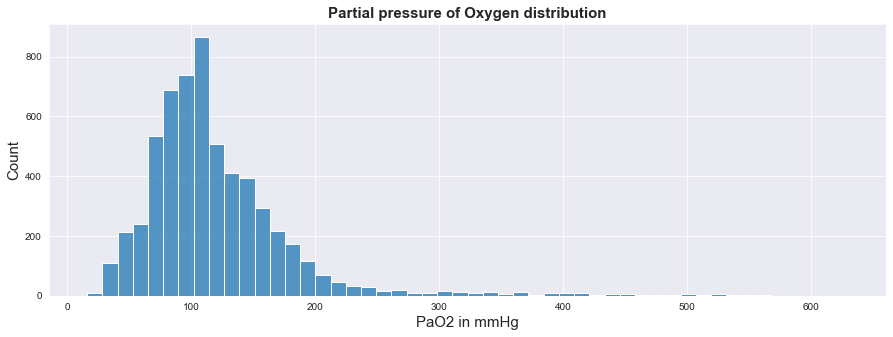

In [82]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.Pa02, bins=50)
ax.set_title("Partial pressure of Oxygen distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('PaO2 in mmHg', fontsize=15);

Due to the skewness of the data, we would like to know how many values are higher then 300 mm Hg?

In [83]:
len(df_raw[df_raw.Pa02 > 300])

145

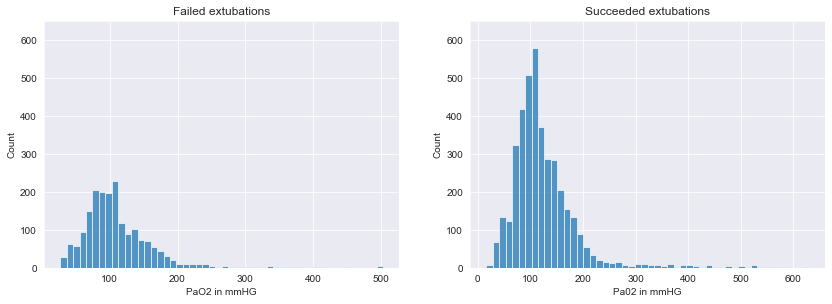

In [84]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].Pa02, bins=50)
ax1.set_ylim(0,650)
plt.xlabel('PaO2 in mmHG')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].Pa02, bins=50)
ax2.set_ylim(0,650)
plt.xlabel('Pa02 in mmHG')
plt.title('Succeeded extubations');

# Base Excess

In [85]:
cleaning(df_raw.base_excess, True)

Amount of unique values: 54
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[1774, 'DISREGARD PREVIOUS RESULT OF 3'], [2267, 'DISREGARD RESULTS'], [4772, '-']] 

Missing in base_excess: 2.29%
Null-Values: 135



##### Replacement of null values with the median

In [86]:
df_raw.base_excess = replacement(df_raw.base_excess, 'median')

Amount of unique values: 51
More than 20 unique values. No printing of details.

Missing in base_excess: 0.0%
Null-Values: 0



In [87]:
df_raw.base_excess.unique()

array([  2.,   4.,  10.,   5.,   6.,  13.,   0.,  -2.,  19.,   1.,   3.,
         8.,  -3.,  -8.,  -6.,  12.,  -9.,  -1.,  -5.,  11.,  -4.,   9.,
        14.,   7., -11.,  22.,  17.,  -7., -14.,  18.,  15., -13., -10.,
       -18., -21.,  21., -12.,  16., -15.,  20., -16.,  27., -19., -17.,
       -20.,  25.,  26.,  24.,  28., -25., -22.])

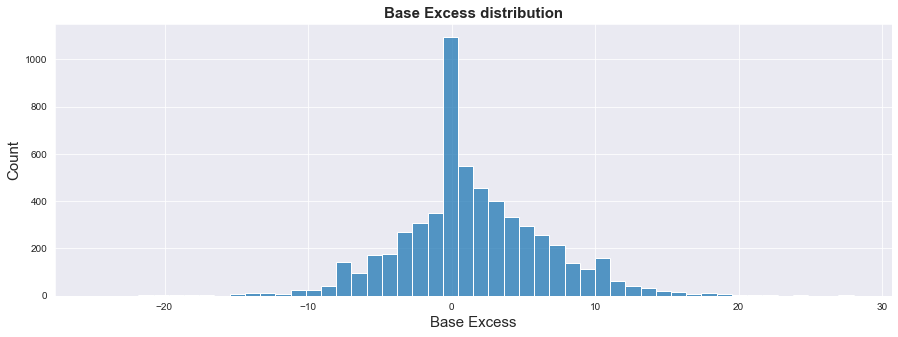

In [88]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.base_excess, bins=50)
ax.set_title("Base Excess distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Base Excess', fontsize=15);

In [89]:
df_raw.base_excess.value_counts()[:5].sort_values(ascending=False)

 0.0    1094
 1.0     548
 2.0     454
 3.0     400
-1.0     351
 4.0     333
-2.0     306
 5.0     296
Name: base_excess, dtype: int64

# Creatinin

In [90]:
cleaning(df_raw.creatinin, True)

Amount of unique values: 113
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[1055, 'LESS THAN 0.5']] 

Missing in creatinin: 0.08%
Null-Values: 5



##### Replacement of uncommon entries.

In [91]:
df_raw[df_raw.creatinin == 'LESS THAN 0.5']

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol
1055,1,118261,288468,19262,M,31.0,9,SICU,16.3515,0,...,100,57.0,NaN,74.0,1.4,10.3,18.0,23.0,34.722198,500.0


In [92]:
df_raw.creatinin.replace('LESS THAN 0.5', '0.3', inplace=True)
df_raw[df_raw.creatinin == 'LESS THAN 0.5']

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol


##### Replacement of null values with the median

In [93]:
df_raw.creatinin = replacement(df_raw.creatinin, 'median')

Amount of unique values: 112
More than 20 unique values. No printing of details.

Missing in creatinin: 0.0%
Null-Values: 0



# Hemoglobin 

In [94]:
cleaning(df_raw.hb, True)

Amount of unique values: 117
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[5329, 'UNABLE TO REPORT']] 

Missing in hb: 0.19%
Null-Values: 11



##### Replacement of null values with the median

In [95]:
df_raw.hb = replacement(df_raw.hb, 'median')

Amount of unique values: 116
More than 20 unique values. No printing of details.

Missing in hb: 0.0%
Null-Values: 0



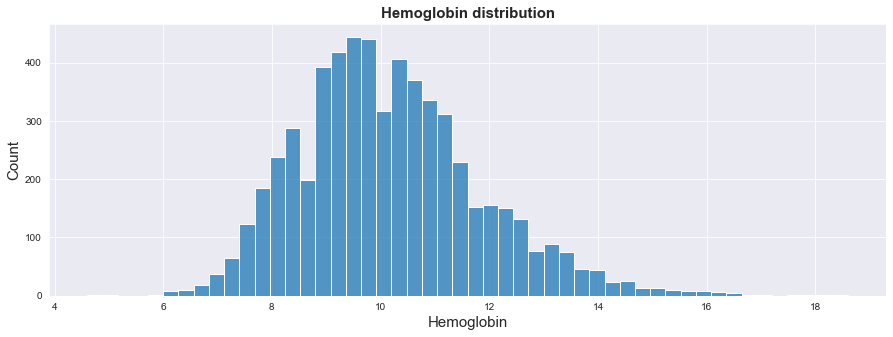

In [96]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.hb, bins=50)
ax.set_title("Hemoglobin distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Hemoglobin', fontsize=15);

# pH Value

In [97]:
cleaning(df_raw.pH, True)

Amount of unique values: 63
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[1774, 'DISREGARD PREVIOUS RESULT OF 7.55.'], [1870, 'GREATER THAN 7.55'], [2267, 'DISREGARD RESULTS']] 

Missing in pH: 2.11%
Null-Values: 124



##### Replacement of uncommon entries

In [98]:
print(df_raw[df_raw.pH == 'DISREGARD PREVIOUS RESULT OF 7.55.'].pH.count())
print(df_raw[df_raw.pH == 'GREATER THAN 7.55'].pH.count())
print(df_raw[df_raw.pH == 'DISREGARD RESULTS'].pH.count())

1
1
1


In [99]:
df_raw.pH.replace('GREATER THAN 7.55', '7.55', inplace=True)
df_raw[df_raw.pH == 'GREATER THAN 7.55']

,label,hadm_id,icustay_id,SUBJECT_ID,gender,sub_age,numb_diagn,last_careunit,los,tracheo,...,SaO2,blood_pr,breath_min_vol,hr,lactic_acid,leuko,mean_insp_pressure,resp_rat,temp,tidal_vol


##### Replacement of null values with the median

In [100]:
df_raw.pH = replacement(df_raw.pH, 'median')

Amount of unique values: 60
More than 20 unique values. No printing of details.

Missing in pH: 0.0%
Null-Values: 0



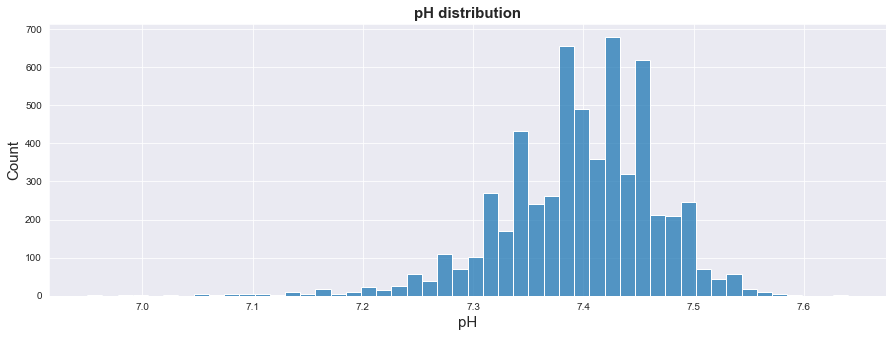

In [101]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.pH, bins=50)
ax.set_title("pH distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('pH', fontsize=15);

# Hematocrit

In [102]:
cleaning(df_raw.hct, True)

Amount of unique values: 301
More than 20 unique values. No printing of details.

Missing in hct: 0.15%
Null-Values: 9



##### Replacement of null values with the median

In [103]:
df_raw.hct = replacement(df_raw.hct, 'median')

Amount of unique values: 301
More than 20 unique values. No printing of details.

Missing in hct: 0.0%
Null-Values: 0



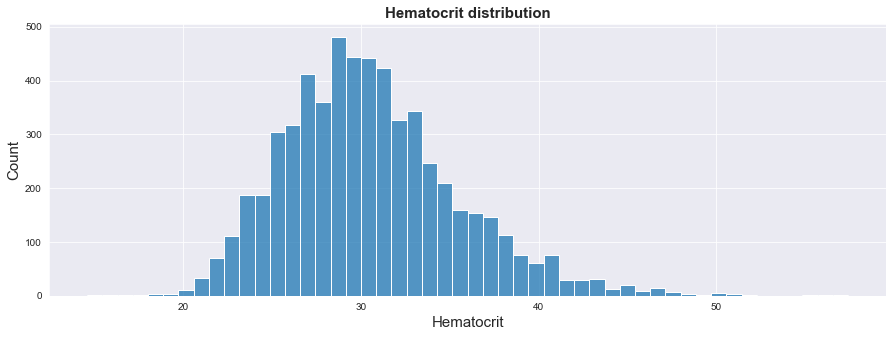

In [104]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.hct, bins=50)
ax.set_title("Hematocrit distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Hematocrit', fontsize=15);

# Heart Rate

In [105]:
cleaning(df_raw.hr, True)

Amount of unique values: 118
More than 20 unique values. No printing of details.

Missing in hr: 0.14%
Null-Values: 8



##### Change datatype to a float 

In [106]:
df_raw.hr= df_raw.hr.astype(float)

In [107]:
df_raw.hr.describe()

count    5876.000000
mean       87.972600
std        17.783792
min         0.000000
25%        75.000000
50%        87.000000
75%       100.000000
max       166.000000
Name: hr, dtype: float64

In [108]:
len(df_raw[df_raw.hr == 0])

6

##### As an en try of 0 heart rate has no biological sense, we assume a typo. Thus, we replace 0 entries by NaN. 

In [109]:
df_raw.hr = df_raw.hr.replace(to_replace= 0, value= np.nan)

##### Replacement of null values with the median

In [110]:
df_raw.hr = replacement(df_raw.hr, 'median')

Amount of unique values: 117
More than 20 unique values. No printing of details.

Missing in hr: 0.0%
Null-Values: 0



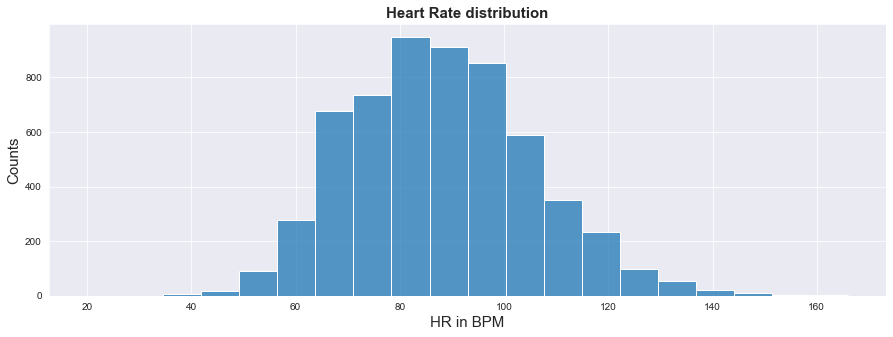

In [111]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.hr, bins=20)
ax.set_title("Heart Rate distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Counts', fontsize=15)
ax.set_xlabel('HR in BPM', fontsize=15);

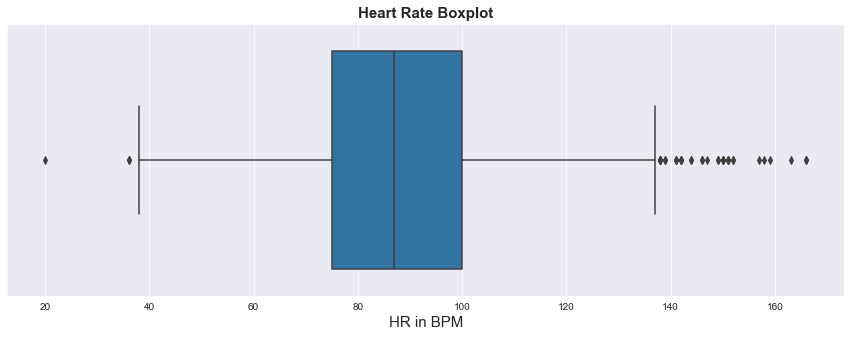

In [112]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.hr)
ax.set_title("Heart Rate Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('HR in BPM', fontsize=15);

**Biological Side Note**: Most healthy adults have a resting heart rate between 60 and 100bpm.  

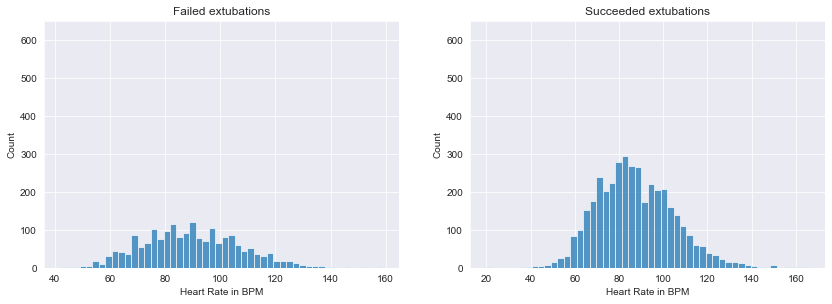

In [113]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].hr, bins=50)
ax1.set_ylim(0,650)
plt.xlabel('Heart Rate in BPM')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].hr, bins=50)
ax2.set_ylim(0,650)
plt.xlabel('Heart Rate in BPM')
plt.title('Succeeded extubations');

# Blood Pressure

In [114]:
cleaning(df_raw.blood_pr, True)

Amount of unique values: 267
More than 20 unique values. No printing of details.

Missing in blood_pr: 0.25%
Null-Values: 15



In [115]:
df_raw.blood_pr.describe()

count    5869.000000
mean       83.553189
std        18.674933
min         0.000000
25%        71.333298
50%        82.000000
75%        94.000000
max       277.000000
Name: blood_pr, dtype: float64

Change datatype to float.

In [116]:
df_raw.blood_pr= df_raw.blood_pr.astype(float)

In [117]:
len(df_raw[df_raw.blood_pr == 0])

2

In [118]:
len(df_raw[df_raw.blood_pr == 3])

1

Since a bloodpressure of zweo and three makes no biological sense, we decide to treat it as a typo and replace the corresponding entries by NaN.  

In [119]:
df_raw.blood_pr = df_raw.blood_pr.replace(to_replace= 0, value= np.nan)

In [120]:
df_raw.blood_pr = df_raw.blood_pr.replace(to_replace= 3, value= np.nan)

##### Replacement of null values with the median

In [121]:
df_raw.blood_pr = replacement(df_raw.blood_pr, 'median')

Amount of unique values: 265
More than 20 unique values. No printing of details.

Missing in blood_pr: 0.0%
Null-Values: 0



''

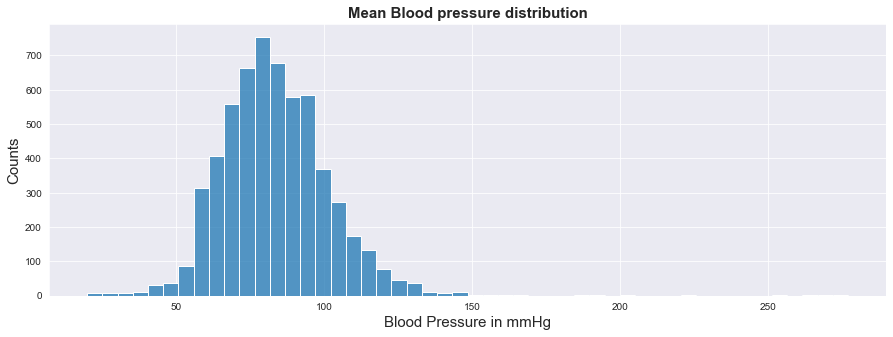

In [122]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.blood_pr, bins=50)
ax.set_title("Mean Blood pressure distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Counts', fontsize=15)
ax.set_xlabel('Blood Pressure in mmHg', fontsize=15);
;

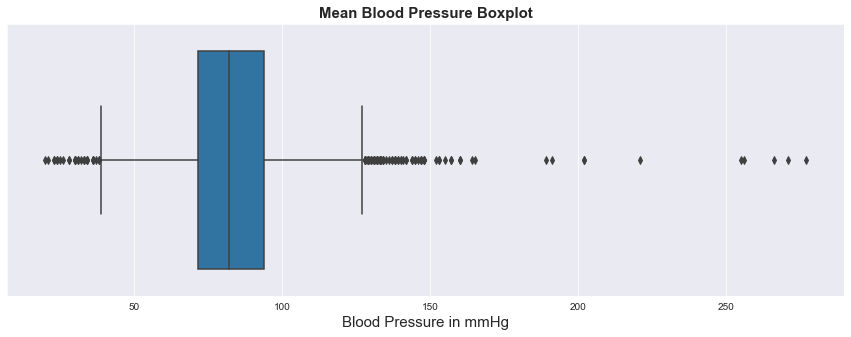

In [123]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.blood_pr)
ax.set_title("Mean Blood Pressure Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('Blood Pressure in mmHg', fontsize=15);

**Biological Side Note**: Doctors usually consider anything between 70 and 100 mmHg to be normal.

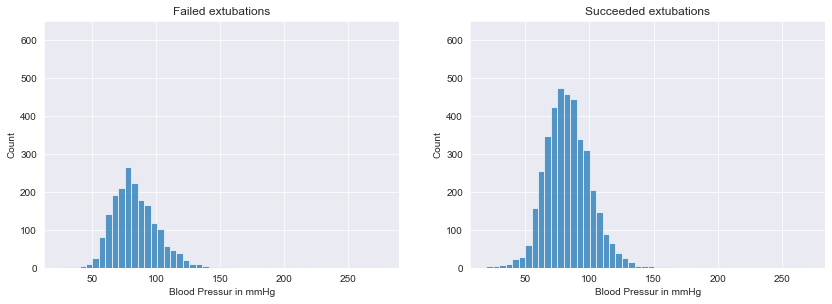

In [124]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].blood_pr, bins=50)
ax1.set_ylim(0,650)
plt.xlabel('Blood Pressur in mmHg')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].blood_pr, bins=50)
ax2.set_ylim(0,650)
plt.xlabel('Blood Pressur in mmHg')
plt.title('Succeeded extubations');

# Temperature

In [125]:
cleaning(df_raw.temp, True)

Amount of unique values: 195
More than 20 unique values. No printing of details.

Missing in temp: 42.59%
Null-Values: 2506



In [126]:
f'Missing in temp: {round(df_raw.temp.isnull().sum()/len(df_raw)*100,2)}%'

'Missing in temp: 42.59%'

Unfortunately, we have too many missing values in this column that makes it impossible to make accurate 
predictions. Thus, we have decided to delete this column entirely.

In [127]:
df_raw.drop('temp', inplace=True, axis = 1)

In [128]:
'temp' in df_raw.columns

False

#  SaO<sub>2</sub>: Saturation of Oxygen

In [129]:
cleaning(df_raw.SaO2, True)

Amount of unique values: 68
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[834, '99 99'], [1774, '100 100'], [3686, '90 90'], [4724, '98 98'], [4921, '97 97'], [5635, '97.0 97.0']] 

Missing in SaO2: 0.29%
Null-Values: 17



Change datatype to a string. 

In [130]:
df_raw.SaO2 = df_raw.SaO2.astype(str)

Split the string at every space. 

In [131]:
df_raw.SaO2 = df_raw.SaO2.apply(lambda x: x.split(' ')[0] if ' ' in x else x)

In [132]:
cleaning(df_raw.SaO2, True)

Amount of unique values: 63
More than 20 unique values. No printing of details.

Missing in SaO2: 0.0%
Null-Values: 0



In [134]:
len(df_raw[df_raw.SaO2<70])

21

If SaO2 is lower than 70%, a patient must be intubated. Thus, values above 70% are not plausible to exist in our data since we only look at the data roight before an extubation. We decide to replace these values by the median.

In [135]:
a = list(df_raw[df_raw.SaO2<70].SaO2.unique())
for i in a:
    df_raw.SaO2 = df_raw.SaO2.replace(to_replace=  i, value= 98)

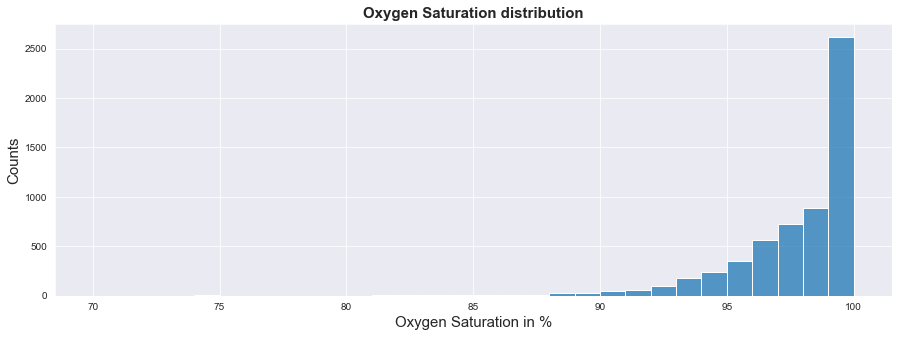

In [136]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.SaO2, bins=30)
ax.set_title("Oxygen Saturation distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Counts', fontsize=15)
ax.set_xlabel('Oxygen Saturation in %', fontsize=15);

# Respiratory Rate

In [137]:
cleaning(df_raw.resp_rat, True)

Amount of unique values: 54
More than 20 unique values. No printing of details.

Missing in resp_rat: 0.2%
Null-Values: 12



In [138]:
df_raw.sort_values('resp_rat', ascending=False).resp_rat.unique()

array([69., 66., 60., 54., 52., 50., 49., 48., 45., 44., 43., 42., 41.,
       40., 39., 38., 37., 36., 35., 34., 33., 32., 31., 30., 29., 28.,
       27., 26., 25., 24., 23., 22., 21., 20., 19., 18., 17., 16., 15.,
       14., 13., 12., 11., 10.,  9.,  8.,  7.,  6.,  5.,  4.,  3.,  2.,
        1.,  0., nan])

Change datatype to a float. 

In [139]:
df_raw.resp_rat= df_raw.resp_rat.astype(float)

In [140]:
len(df_raw[df_raw.resp_rat == 0])

26

In [141]:
df_raw.resp_rat = df_raw.resp_rat.replace(to_replace= 0, value= np.nan)

##### Replace Missing Values with the Median.

In [142]:
df_raw.resp_rat = replacement(df_raw.resp_rat, 'median')

Amount of unique values: 53
More than 20 unique values. No printing of details.

Missing in resp_rat: 0.0%
Null-Values: 0



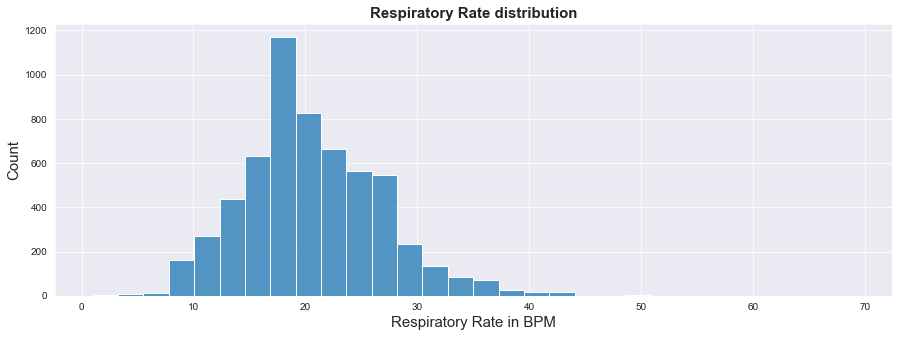

In [143]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.resp_rat, bins=30)
ax.set_title("Respiratory Rate distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Respiratory Rate in BPM', fontsize=15);

# Tidal Volume

In [144]:
cleaning(df_raw.tidal_vol, True)

Amount of unique values: 782
More than 20 unique values. No printing of details.

Missing in tidal_vol: 1.26%
Null-Values: 74



Change datatype to a float. 

In [145]:
df_raw.tidal_vol= df_raw.tidal_vol.astype(float)

In [146]:
df_raw.tidal_vol.describe()

count    5810.000000
mean      473.240062
std       193.540879
min         0.000000
25%       372.000000
50%       460.000000
75%       560.000000
max      6000.000000
Name: tidal_vol, dtype: float64

##### Outlier handling

In [147]:
len(df_raw[df_raw.tidal_vol > 2000])

2

In [148]:
len(df_raw[df_raw.tidal_vol == 0])

124

In [149]:
df_raw.tidal_vol = df_raw.tidal_vol.replace(to_replace= 0, value= np.nan)

In [150]:
df_raw.tidal_vol = df_raw.tidal_vol.replace(to_replace= 6000, value= np.nan)

In [151]:
df_raw.tidal_vol = df_raw.tidal_vol.replace(to_replace= 4775, value= np.nan)

##### Replace Missing Values with the Median.

In [152]:
df_raw.tidal_vol = replacement(df_raw.tidal_vol, 'median')

Amount of unique values: 779
More than 20 unique values. No printing of details.

Missing in tidal_vol: 0.0%
Null-Values: 0



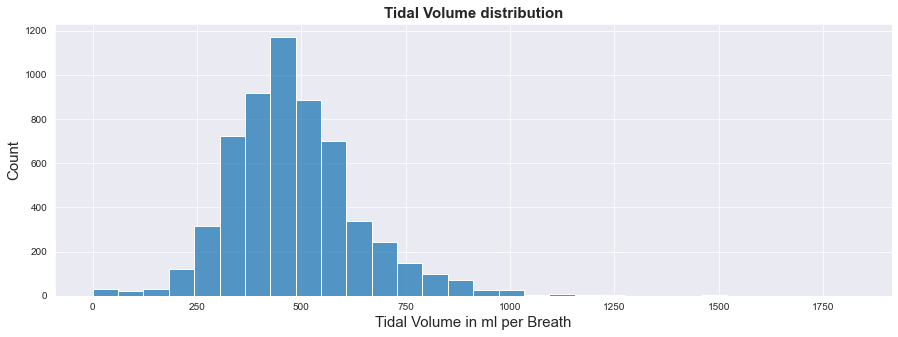

In [153]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.tidal_vol, bins=30)
ax.set_title("Tidal Volume distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Tidal Volume in ml per Breath', fontsize=15);

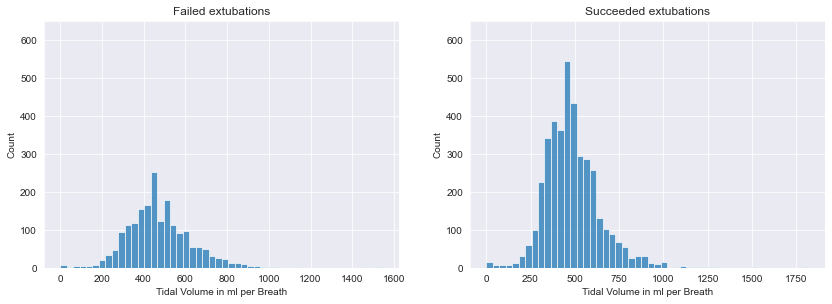

In [154]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].tidal_vol, bins=50)
ax1.set_ylim(0,650)
plt.xlabel('Tidal Volume in ml per Breath')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].tidal_vol, bins=50)
ax2.set_ylim(0,650)
plt.xlabel('Tidal Volume in ml per Breath')
plt.title('Succeeded extubations');

# Breath-Minute-Volume

In [155]:
cleaning(df_raw.breath_min_vol, True)

Amount of unique values: 310
More than 20 unique values. No printing of details.

Missing in breath_min_vol: 51.63%
Null-Values: 3038



The given Breath-Minute-Volume entries contain around 52% missing values. This way, we cannot use these entries. However, we can engineer the Breath-Minute-Volume by multiplying the Tidal Volume by Respiratory Rate. Thus, we decide to calculate the Breath-Minute-Volume ourselves. 

In [156]:
df_raw.eval('breath_minute_vol = resp_rat * tidal_vol / 1000', inplace=True)

In [157]:
df_raw.breath_minute_vol.unique()

array([11.754,  8.6  ,  2.416, ...,  9.128,  0.87 ,  6.509])

In [158]:
df_raw.columns

Index(['label', 'hadm_id', 'icustay_id', 'SUBJECT_ID', 'gender', 'sub_age',
       'numb_diagn', 'last_careunit', 'los', 'tracheo', 'Pa02', 'base_excess',
       'creatinin', 'hb', 'hct', 'pH', 'FiO2', 'PEEP', 'SaO2', 'blood_pr',
       'breath_min_vol', 'hr', 'lactic_acid', 'leuko', 'mean_insp_pressure',
       'resp_rat', 'tidal_vol', 'breath_minute_vol'],
      dtype='object')

In [159]:
df_raw[['breath_minute_vol','breath_min_vol']].describe()

,breath_minute_vol,breath_min_vol
count,5884.000000,2846.000000
mean,9.679539,9.511954
std,3.786926,14.829191
min,0.006660,0.000000
25%,7.207250,7.000000
50%,9.145000,8.800000
75%,11.524000,10.900000
max,40.590000,777.000000


In [160]:
df_raw.drop('breath_min_vol', inplace=True, axis=1)

In [161]:
cleaning(df_raw.breath_minute_vol, True)

Amount of unique values: 2768
More than 20 unique values. No printing of details.

Missing in breath_minute_vol: 0.0%
Null-Values: 0



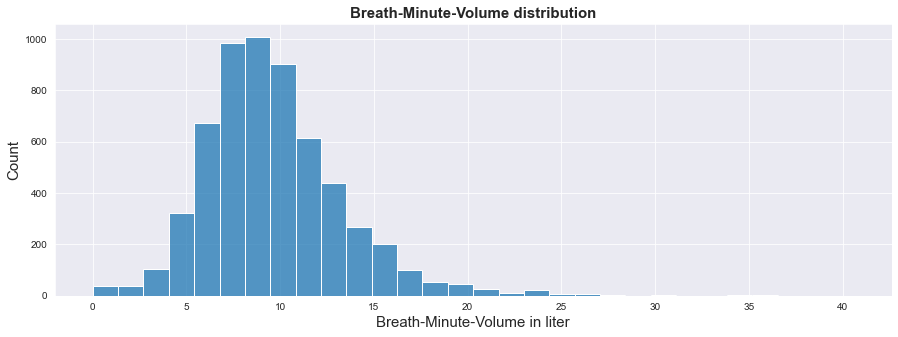

In [162]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.breath_minute_vol, bins=30)
ax.set_title("Breath-Minute-Volume distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Breath-Minute-Volume in liter', fontsize=15);

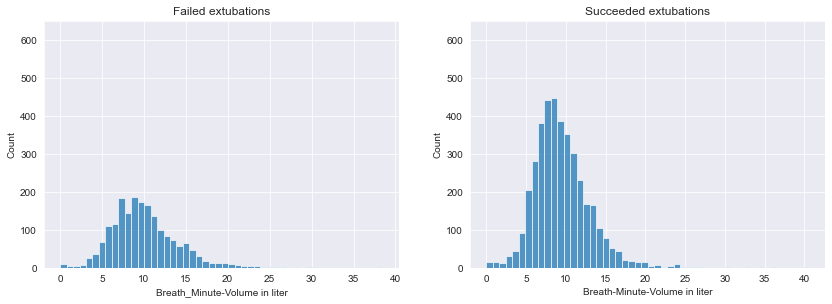

In [163]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].breath_minute_vol, bins=50)
ax1.set_ylim(0,650)
plt.xlabel('Breath_Minute-Volume in liter')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].breath_minute_vol, bins=50)
ax2.set_ylim(0,650)
plt.xlabel('Breath-Minute-Volume in liter')
plt.title('Succeeded extubations');

# FiO<sub>2</sub> : Fraction of Inspired Oxygen

In [164]:
cleaning(df_raw.FiO2, True)

Amount of unique values: 51
More than 20 unique values. No printing of details.

Missing in FiO2: 0.87%
Null-Values: 51



In [165]:
df_raw.sort_values('FiO2', ascending=False).FiO2.unique()

array([100.        ,  96.        ,  95.        ,  90.        ,
        80.        ,  75.        ,  70.        ,  65.        ,
        60.        ,  55.        ,  51.        ,  50.        ,
        45.        ,  41.        ,  40.        ,  39.        ,
        36.        ,  35.        ,  32.        ,  31.        ,
        30.        ,  28.        ,  26.        ,  25.        ,
        24.        ,  21.        ,   3.        ,   1.        ,
         0.89999998,   0.80000001,   0.80000001,   0.75      ,
         0.69999999,   0.64999998,   0.60000002,   0.55000001,
         0.5       ,   0.44999999,   0.40099999,   0.40000001,
         0.4       ,   0.34999999,   0.34      ,   0.30000001,
         0.28      ,   0.27000001,   0.25999999,   0.25      ,
         0.23999999,   0.20999999,   0.        ,          nan])

The value is given in different units: 
percent or decimal number between 0 and 1.   
To make the values ​​comparable, the decimal numbers are multiplied by 100.

In [166]:
a = list(df_raw[df_raw.FiO2<= 1].FiO2.unique())
for i in a:
    df_raw.FiO2 = df_raw.FiO2.replace(to_replace=  i, value= i * 100)

In [167]:
df_raw.sort_values('FiO2', ascending=False).FiO2.unique()

array([100.        ,  96.        ,  95.        ,  90.        ,
        89.99999762,  80.00000119,  80.00000119,  80.        ,
        75.        ,  70.        ,  69.99999881,  65.        ,
        64.99999762,  60.00000238,  60.        ,  55.00000119,
        55.        ,  51.        ,  50.        ,  45.        ,
        44.99999881,  41.        ,  40.09999931,  40.0000006 ,
        40.        ,  39.        ,  36.        ,  35.        ,
        34.9999994 ,  34.00000036,  32.        ,  31.        ,
        30.00000119,  30.        ,  28.00000012,  28.        ,
        27.00000107,  26.        ,  25.99999905,  25.        ,
        24.        ,  23.99999946,  21.        ,  20.99999934,
         3.        ,   0.        ,          nan])

In [168]:
len(df_raw[df_raw.FiO2 == 0])

4

In [169]:
len(df_raw[df_raw.FiO2 == 3])

1

The values ​​0 and 3 make no medical sense, therefore they are treated as errors and set to NaN. 

In [170]:
df_raw.FiO2 = df_raw.FiO2.replace(to_replace= 0, value= np.nan)
df_raw.FiO2 = df_raw.FiO2.replace(to_replace= 3, value= np.nan)

In [171]:
df_raw.FiO2 = replacement(df_raw.FiO2, 'median')

Amount of unique values: 44
More than 20 unique values. No printing of details.

Missing in FiO2: 0.0%
Null-Values: 0



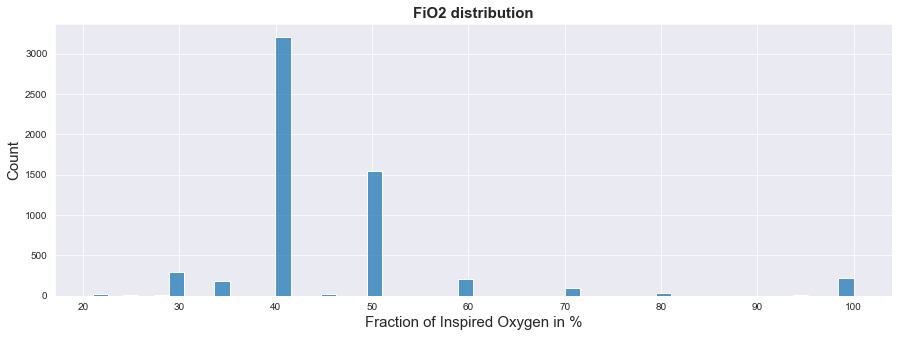

In [172]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.FiO2, bins=50)
ax.set_title("FiO2 distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Fraction of Inspired Oxygen in %', fontsize=15);

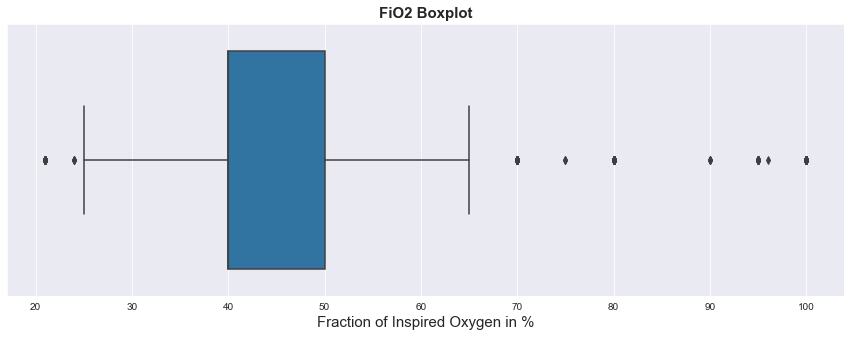

In [173]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.FiO2)
ax.set_title("FiO2 Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('Fraction of Inspired Oxygen in %', fontsize=15);

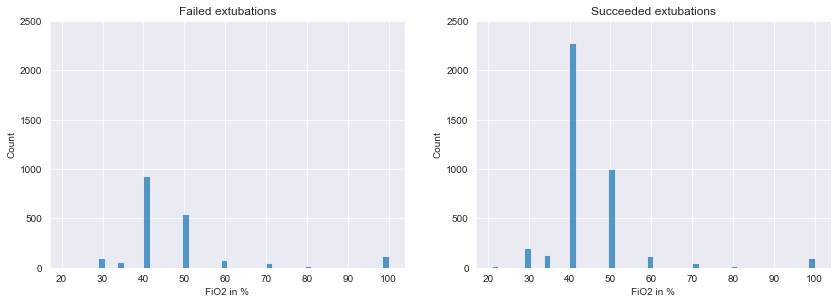

In [174]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].FiO2, bins=50)
ax1.set_ylim(0,2500)
plt.xlabel('FiO2 in %')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].FiO2, bins=50)
ax2.set_ylim(0,2500)
plt.xlabel('FiO2 in %')
plt.title('Succeeded extubations');

# PEEP: Positive end-expiratory pressure

In [175]:
cleaning(df_raw.PEEP, True)

Amount of unique values: 30
More than 20 unique values. No printing of details.

Missing in PEEP: 1.33%
Null-Values: 78



In [176]:
df_raw.sort_values('PEEP', ascending=False).PEEP.unique()

array([24.        , 23.        , 22.        , 20.        , 18.        ,
       17.        , 16.        , 15.        , 14.        , 13.        ,
       12.5       , 12.30000019, 12.        , 10.        ,  8.        ,
        7.5999999 ,  7.5       ,  7.        ,  6.        ,  5.4000001 ,
        5.19999981,  5.0999999 ,  5.        ,  4.9000001 ,  4.69999981,
        4.5999999 ,  4.        ,  3.        ,  2.        ,  0.        ,
               nan])

In [177]:
len(df_raw[df_raw.PEEP == 0])

1157

##### Replace Missing Values with the Median.

In [178]:
df_raw.PEEP = replacement(df_raw.PEEP, 'median')

Amount of unique values: 30
More than 20 unique values. No printing of details.

Missing in PEEP: 0.0%
Null-Values: 0



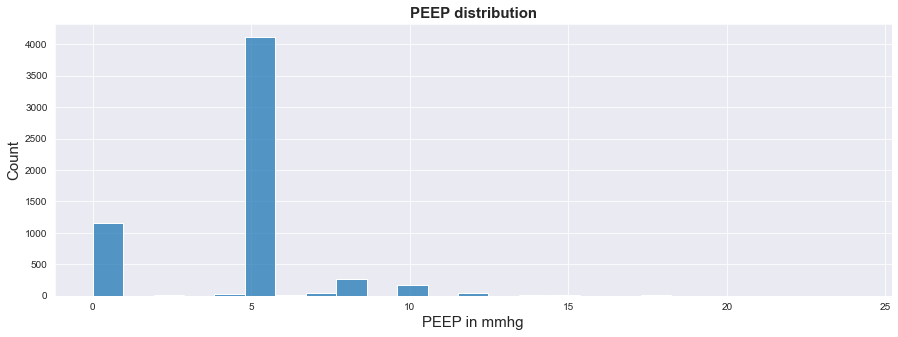

In [179]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.PEEP, bins=25)
ax.set_title("PEEP distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('PEEP in mmhg', fontsize=15);

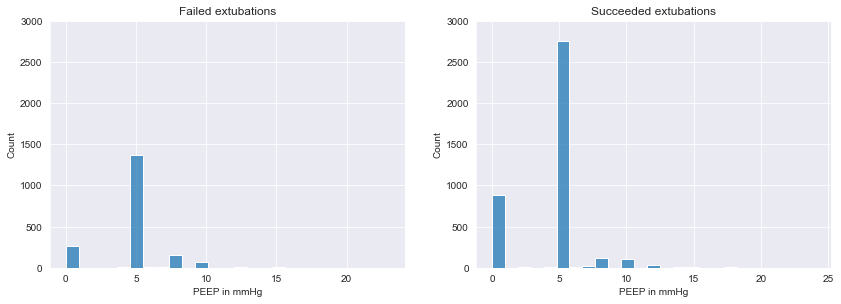

In [181]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].PEEP, bins=25)
ax1.set_ylim(0,3000)
plt.xlabel('PEEP in mmHg')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].PEEP, bins=25)
ax2.set_ylim(0,3000)
plt.xlabel('PEEP in mmHg')
plt.title('Succeeded extubations');

# 

# Mean Inspiration Pressure

In [182]:
cleaning(df_raw.mean_insp_pressure, True)

Amount of unique values: 149
More than 20 unique values. No printing of details.

Missing in mean_insp_pressure: 2.62%
Null-Values: 154



In [183]:
len(df_raw[df_raw.mean_insp_pressure == 0])

83

##### Replace Missing Values with the Median.

In [184]:
df_raw.mean_insp_pressure = replacement(df_raw.mean_insp_pressure, 'median')

Amount of unique values: 149
More than 20 unique values. No printing of details.

Missing in mean_insp_pressure: 0.0%
Null-Values: 0



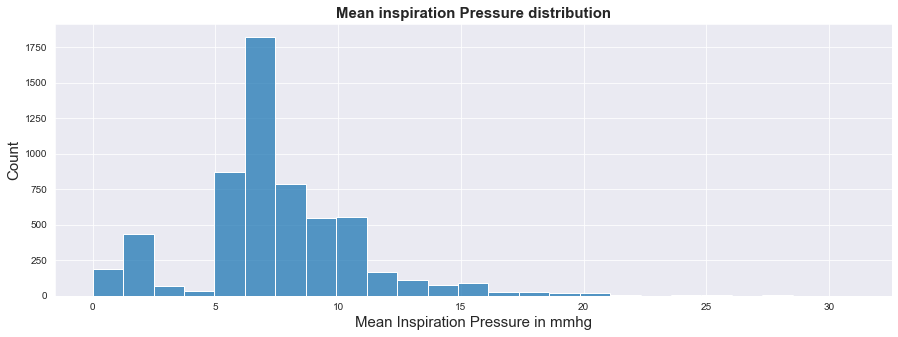

In [185]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.mean_insp_pressure, bins=25)
ax.set_title("Mean inspiration Pressure distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Mean Inspiration Pressure in mmhg', fontsize=15);

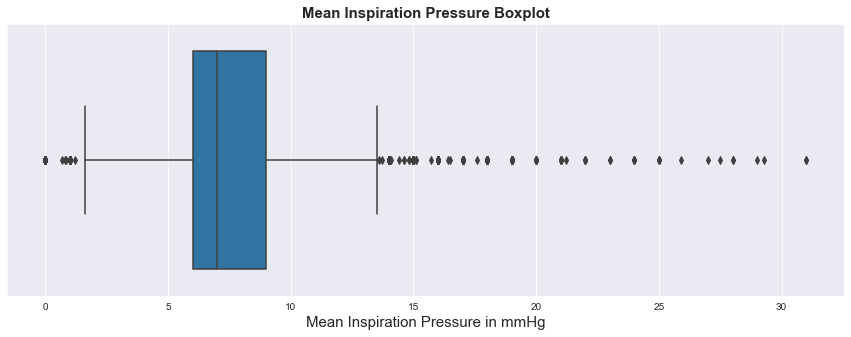

In [186]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.mean_insp_pressure)
ax.set_title("Mean Inspiration Pressure Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('Mean Inspiration Pressure in mmHg', fontsize=15);

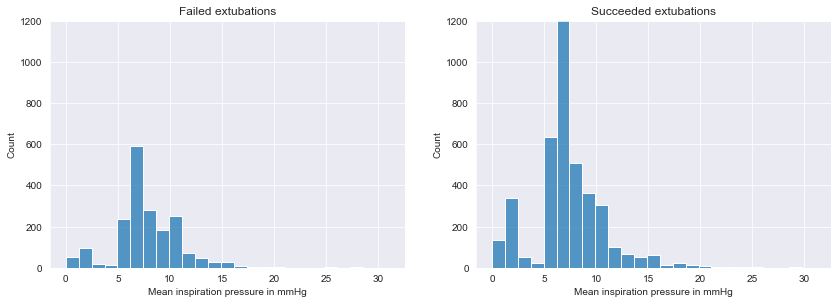

In [187]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].mean_insp_pressure, bins=25)
ax1.set_ylim(0,1200)
plt.xlabel('Mean inspiration pressure in mmHg')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].mean_insp_pressure, bins=25)
ax2.set_ylim(0, 1200)
plt.xlabel('Mean inspiration pressure in mmHg')
plt.title('Succeeded extubations');

# Leukocytes

In [188]:
cleaning(df_raw.leuko, True)

Amount of unique values: 479
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[83, '19.5 19.5'], [119, '8.9 8.9'], [121, '5 5'], [124, '10.2 10.2'], [306, '10.3 10.3'], [310, '13.3 13.3'], [435, '10.2 10.2'], [501, '6.3 6.3'], [579, '9.1 9.1'], [581, '92.4 92.4'], [693, '4 4'], [699, '15.5 15.5'], [707, '8.4 8.4'], [801, '5.5 5.5'], [834, '6.7 6.7'], [880, '20.5 20.5'], [958, '<0.1*'], [988, '10.5 10.5'], [1008, '22.3 22.3'], [1070, '10.1 10.1'], [1099, '16.7 16.7'], [1123, '6.8 6.8'], [1167, '9.4 9.4'], [1420, '11.8 11.8'], [1613, '4.4 4.4'], [1681, '8.1 8.1'], [1764, '<0.1*'], [1768, '11.2 11.2'], [1774, '20 20'], [1797, '16.4 16.4'], [1876, '13.7 13.7'], [1877, '6.5 6.5'], [1914, '14.3 14.3'], [1978, '17.4 17.4'], [2042, '10.7 10.7'], [2068, '9.8 9.8'], [2091, '13 13'], [2137, '9.6 9.6'], [2156, '15.7 15.7'], [2183, '42 42'], [2366, '11.5 11.5'], [2552, '8.6 8.6'], [2598

In [190]:
len(df_raw[df_raw.leuko == '<0.1*'])

2

##### Clean Datatypes

In [191]:
df_raw.leuko = df_raw.leuko.replace(to_replace= '<0.1*', value= 0.1)

In [192]:
df_raw.leuko = df_raw.leuko.astype(str)

In [193]:
df_raw.leuko = df_raw.leuko.apply(lambda x: x.split(' ')[0] if ' ' in x else x)

In [194]:
df_raw.leuko = df_raw.leuko.astype(float)

In [195]:
len(df_raw[df_raw.leuko > 55])

16

It is medicaly impossible to have a leukocyte measure higher than 55 x 10<sup>3</sup>/μL). Thus, we replace them by the value divided by 10 as we believe this to be the right medical ibnterpretation. 

In [196]:
a = list(df_raw[df_raw.leuko > 55].leuko.unique())
for i in a:
   df_raw.leuko = df_raw.leuko.replace(to_replace= i , value= i/10)

In [197]:
df_raw.leuko = replacement(df_raw.leuko, 'median')

Amount of unique values: 380
More than 20 unique values. No printing of details.

Missing in leuko: 0.0%
Null-Values: 0



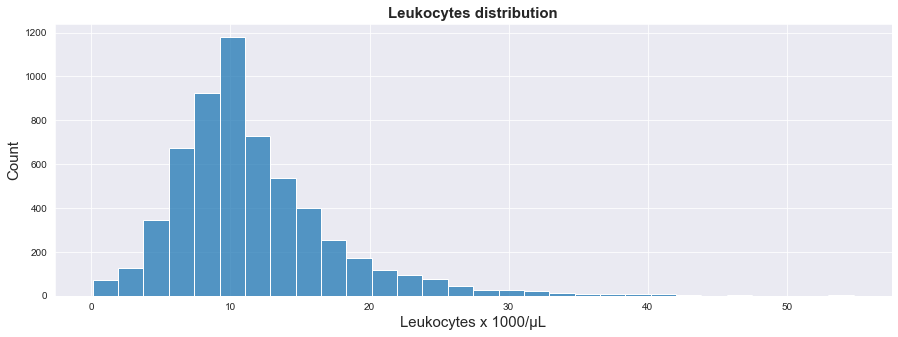

In [198]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.leuko, bins=30)
ax.set_title("Leukocytes distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Leukocytes x 1000/μL', fontsize=15);

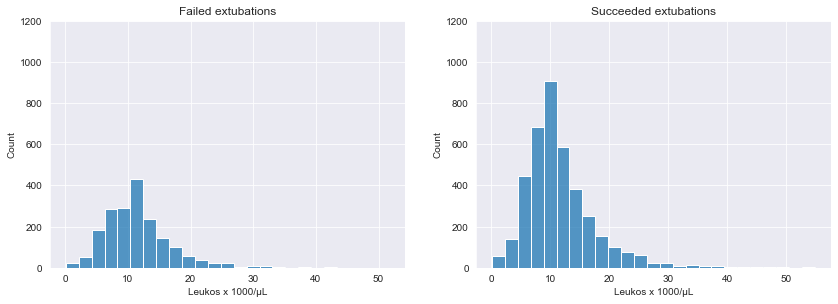

In [199]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].leuko, bins=25)
ax1.set_ylim(0,1200)
plt.xlabel('Leukos x 1000/μL')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].leuko, bins=25)
ax2.set_ylim(0, 1200)
plt.xlabel('Leukos x 1000/μL')
plt.title('Succeeded extubations');

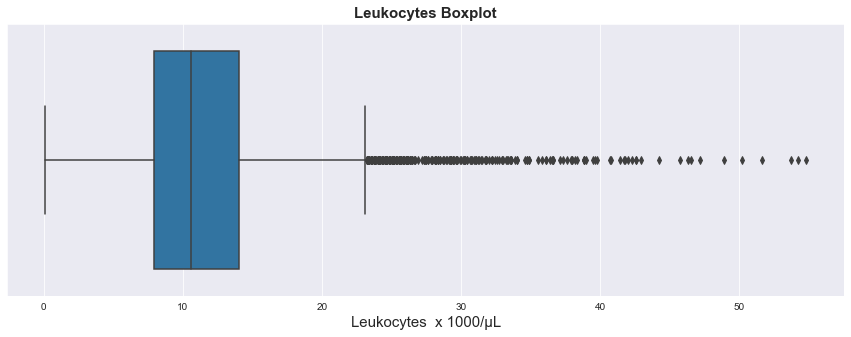

In [200]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.leuko)
ax.set_title("Leukocytes Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('Leukocytes  x 1000/μL', fontsize=15);

# Lactic Acid 

In [201]:
cleaning(df_raw.lactic_acid, True)

Amount of unique values: 153
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[29, '.5 .5'], [83, '1.3 1.3'], [119, '2.8 2.8'], [121, '2.4 2.4'], [306, '1.1 1.1'], [310, '1.8 1.8'], [422, '1.7 1.7'], [434, '.8 .8'], [435, '.9 .9'], [579, '.9 .9'], [693, '.9 .9'], [699, '2 2'], [707, '.9 .9'], [801, '1.1 1.1'], [834, '1.8 1.8'], [880, '1.7 1.7'], [988, '2.3 2.3'], [1008, '1.2 1.2'], [1070, '.9 .9'], [1081, '1.4 1.4'], [1099, '1 1'], [1123, '1.1 1.1'], [1420, '1.3 1.3'], [1613, '1.2 1.2'], [1681, '1.6 1.6'], [1768, '1.7 1.7'], [1774, '1 1'], [1797, '1.8 1.8'], [1876, '1.1 1.1'], [1895, '.9 .9'], [1914, '1.4 1.4'], [1978, '1.5 1.5'], [2042, '1.3 1.3'], [2091, '1.3 1.3'], [2183, '7.9 7.9'], [2267, 'no data'], [2366, '1.8 1.8'], [2552, '2.3 2.3'], [2553, '1.4 1.4'], [2598, '1 1'], [2607, '1.8 1.8'], [2608, '13.6 13.6'], [2619, '1.7 1.7'], [2675, '.7 .7'], [2694, '1.7 1.7'], [270

Change datatype to string. 

In [202]:
df_raw.lactic_acid= df_raw.lactic_acid.astype(str)

In [203]:
df_raw.lactic_acid = df_raw.lactic_acid.apply(lambda x: x.split(' ')[0] if ' ' in x else x)

In [204]:
cleaning(df_raw.lactic_acid, True)

Amount of unique values: 130
More than 20 unique values. No printing of details.

Replace the non numeric entries by numeric entries or NaN. Restart the cleaning function, after replacement.
[[2267, 'no']] 

Missing in lactic_acid: 0.0%
Null-Values: 0



df_raw.lactic_acid = df_raw.lactic_acid.replace(to_replace= 'no', value= np.nan)

In [206]:
cleaning(df_raw.lactic_acid, True)

Amount of unique values: 129
More than 20 unique values. No printing of details.

Missing in lactic_acid: 0.02%
Null-Values: 1



In [207]:
df_raw.lactic_acid= df_raw.lactic_acid.astype(float)

In [208]:
len(df_raw[df_raw.lactic_acid> 20])

6

We think this values are typos.  We replace them by the value divided by 10.

In [209]:
a = list(df_raw[df_raw.lactic_acid >20].lactic_acid.unique())
for i in a:
    df_raw.lactic_acid = df_raw.lactic_acid.replace(to_replace= i , value= i/10)

In [210]:
df_raw[['pH', 'base_excess','Pa02', 'lactic_acid']]

,pH,base_excess,Pa02,lactic_acid
0,7.43,2.0,86.0,NaN
1,7.52,4.0,171.0,1.1
2,7.41,10.0,39.0,1.0
3,7.39,2.0,365.0,NaN
4,7.47,5.0,143.0,1.3
5,7.48,6.0,62.0,1.5
6,7.49,13.0,122.0,1.7
7,7.39,0.0,156.0,0.7
8,7.46,6.0,105.0,0.8
9,7.36,-2.0,146.0,1.0


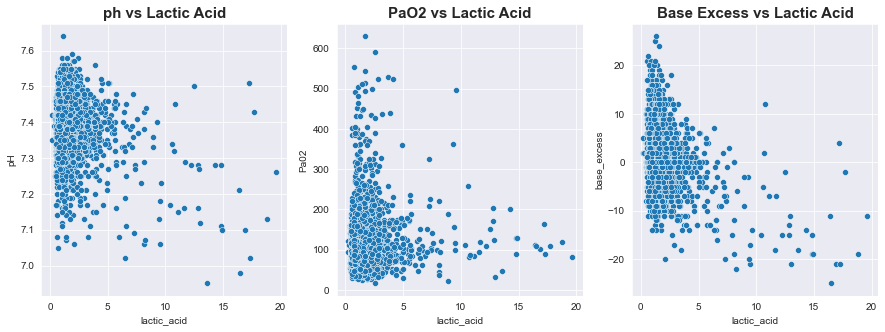

In [211]:
fig, ax =plt.subplots(1,3,figsize=(15, 5))
sns.set_style("ticks")
ax1 = sns.scatterplot(x = df_raw.lactic_acid , y = df_raw.pH, ax=ax[0])
ax2 = sns.scatterplot(x = df_raw.lactic_acid , y = df_raw.Pa02, ax=ax[1])
ax3 = sns.scatterplot(x = df_raw.lactic_acid , y = df_raw.base_excess, ax=ax[2])
ax1.set_title("ph vs Lactic Acid", fontsize=15, fontweight="bold")
ax2.set_title("PaO2 vs Lactic Acid", fontsize=15, fontweight="bold")
ax3.set_title("Base Excess vs Lactic Acid", fontsize=15, fontweight="bold");

We cannot see any significant correlation between the values of lactid acid and blood gases. So we going to choose the median as a replacement for the missing values.

In [212]:
df_raw.lactic_acid = replacement(df_raw.lactic_acid, 'median')

Amount of unique values: 119
More than 20 unique values. No printing of details.

Missing in lactic_acid: 0.0%
Null-Values: 0



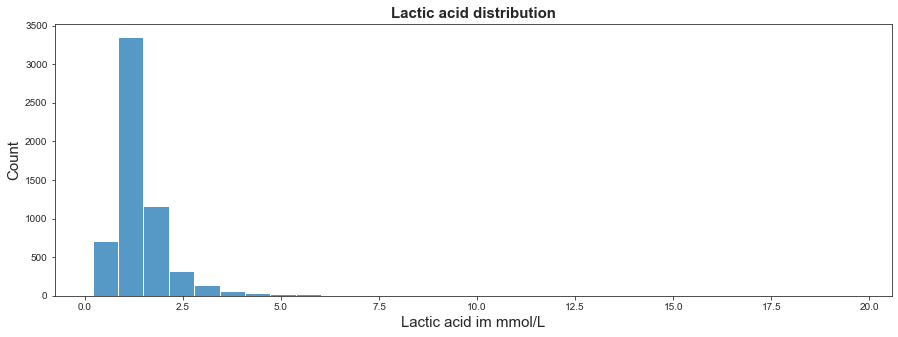

In [213]:
plt.figure(figsize=(15,5))
ax = sns.histplot(df_raw.lactic_acid, bins=30)
ax.set_title("Lactic acid distribution", fontsize=15, fontweight="bold")
ax.set_ylabel('Count', fontsize=15)
ax.set_xlabel('Lactic acid im mmol/L', fontsize=15);

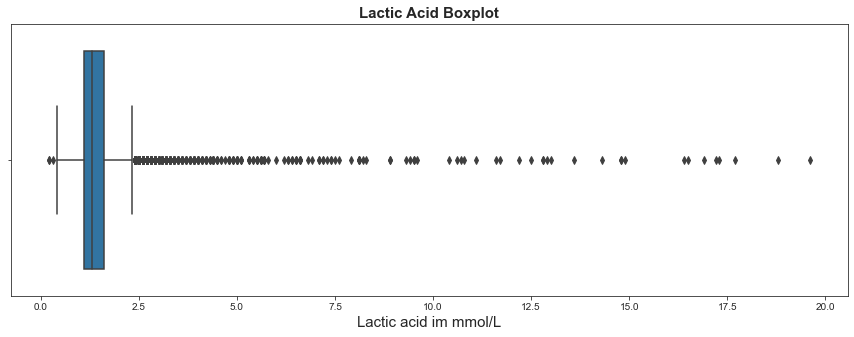

In [214]:
plt.figure(figsize=(15,5))
ax = sns.boxplot(df_raw.lactic_acid)
ax.set_title("Lactic Acid Boxplot", fontsize=15, fontweight="bold")
ax.set_xlabel('Lactic acid im mmol/L', fontsize=15);

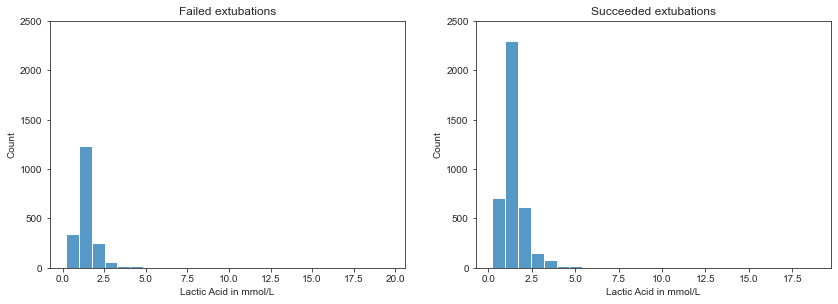

In [215]:
fig = plt.figure(figsize=(14,10))
ax1 = fig.add_subplot(2, 2, 1)
ax1 = sns.histplot(df_raw[df_raw.label==0].lactic_acid, bins=25)
ax1.set_ylim(0,2500)
plt.xlabel('Lactic Acid in mmol/L')
plt.title('Failed extubations')

ax2 = fig.add_subplot(2, 2, 2)
ax2 = sns.histplot(df_raw[df_raw.label==1].lactic_acid, bins=25)
ax2.set_ylim(0, 2500)
plt.xlabel('Lactic Acid in mmol/L')
plt.title('Succeeded extubations');

# Change the names of the columns

In [216]:
df_raw.columns

Index(['label', 'hadm_id', 'icustay_id', 'SUBJECT_ID', 'gender', 'sub_age',
       'numb_diagn', 'last_careunit', 'los', 'tracheo', 'Pa02', 'base_excess',
       'creatinin', 'hb', 'hct', 'pH', 'FiO2', 'PEEP', 'SaO2', 'blood_pr',
       'hr', 'lactic_acid', 'leuko', 'mean_insp_pressure', 'resp_rat',
       'tidal_vol', 'breath_minute_vol'],
      dtype='object')

In [217]:
df_raw.rename(columns={'SUBJECT_ID': 'subject_id',
                  'sub_age': 'age' , 
                  'Pa02': 'PaO2',
                  'mean_insp_pressure':'mean_insp_pr',
                  'breath_minute_vol': 'breath_min_vol'}, inplace=True)

# Drop columns

In [218]:
df_raw.columns

Index(['label', 'hadm_id', 'icustay_id', 'subject_id', 'gender', 'age',
       'numb_diagn', 'last_careunit', 'los', 'tracheo', 'PaO2', 'base_excess',
       'creatinin', 'hb', 'hct', 'pH', 'FiO2', 'PEEP', 'SaO2', 'blood_pr',
       'hr', 'lactic_acid', 'leuko', 'mean_insp_pr', 'resp_rat', 'tidal_vol',
       'breath_min_vol'],
      dtype='object')

In [219]:
df_raw.drop(['subject_id'], axis=1, inplace=True)

We decided to remove LOS from the dataset because we are concerned about data leakage. Patients who are generally in intensive care for longer periods of time usually have more serious diagnoses and the likelihood of extubation success is affected by the poor health of the patient

In [220]:
df_raw.drop(['los'], axis=1, inplace=True)

In [221]:
df_raw.columns

Index(['label', 'hadm_id', 'icustay_id', 'gender', 'age', 'numb_diagn',
       'last_careunit', 'tracheo', 'PaO2', 'base_excess', 'creatinin', 'hb',
       'hct', 'pH', 'FiO2', 'PEEP', 'SaO2', 'blood_pr', 'hr', 'lactic_acid',
       'leuko', 'mean_insp_pr', 'resp_rat', 'tidal_vol', 'breath_min_vol'],
      dtype='object')

# Export the clean dataframe as csv file

In [222]:
df_raw.to_csv('./data/mimic_clean.csv', index = False)